# Latent Code Exploration
This is a notebook that performs some experimentation on the latent code from the EG3D domain. This involves changing the latent code, to explore the relation between, changes in EG3D latent code and face attributes/features such as smile, hair color, hair length, pose, etc. This experimentation focuses on exploring the facial expressions, by changes in latent code.

## Dependencies

In [ ]:
#@title Download EG3D
!nvidia-smi
!git clone https://github.com/NVlabs/eg3d

Thu Sep 15 15:55:18 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    23W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#@title Download EG3D model
model_url = "https://api.ngc.nvidia.com/v2/models/nvidia/research/eg3d/versions/1/files/ffhq512-128.pkl"  #@param {type: "string"}
!wget -c $model_url -O model.pkl
#feature_detector_url = !wget 'https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metrics/vgg16.pt' # @param {type:string} feature detector
#!wget -c $feature_detector_url -O vgg16.pt

--2022-09-15 15:55:26--  https://api.ngc.nvidia.com/v2/models/nvidia/research/eg3d/versions/1/files/ffhq512-128.pkl
Resolving api.ngc.nvidia.com (api.ngc.nvidia.com)... 54.241.219.166, 54.219.126.165
Connecting to api.ngc.nvidia.com (api.ngc.nvidia.com)|54.241.219.166|:443... connected.
HTTP request sent, awaiting response... 302 
Location: https://prod-model-registry-ngc-bucket.s3.us-west-2.amazonaws.com/org/nvidia/team/research/models/eg3d/versions/1/files/ffhq512-128.pkl?response-content-disposition=attachment%3B%20filename%3D%22ffhq512-128.pkl%22&response-content-type=application%2Foctet-stream&X-Amz-Security-Token=IQoJb3JpZ2luX2VjEEAaCXVzLXdlc3QtMiJGMEQCIFPuWfHRhIZBpN0bUV%2BckKMM3g0sl08EwI627KjDdwINAiAuJhhfkEZsx1xZ1M4reDx3h1mzDAf%2F5wqqRQ1hExG7jCrVBAjZ%2F%2F%2F%2F%2F%2F%2F%2F%2F%2F8BEAQaDDc4OTM2MzEzNTAyNyIM2zx6%2BFMChYzQ%2FOgPKqkEXUUjApQ8Bm679%2FWJh3DC8t8C%2BYByiFojrEQea1x2GKwvIWTmZdInOV32M%2F54FQ6dsInQnuHcWMa8waP6joCu58Nb%2BuHmDUI%2BTannlfqkeMZqR1qS5k%2BKOeZUYml%2BPCI67kwbe0OkmoL

In [ ]:
!sudo apt install ninja-build

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following NEW packages will be installed:
  ninja-build
0 upgraded, 1 newly installed, 0 to remove and 32 not upgraded.
Need to get 93.3 kB of archives.
After this operation, 296 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 ninja-build amd64 1.8.2-1 [93.3 kB]
Fetched 93.3 kB in 0s (214 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-

In [ ]:
!pip install scikit-video

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.3 MB 13.0 MB/s 


In [ ]:
!pip install lpips

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 53 kB 2.2 MB/s 


In [ ]:
!pip install trimesh
!pip install imageio-ffmpeg 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 660 kB 14.3 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 26.9 MB 1.5 MB/s 


## Import

In [ ]:
import sys
if "./eg3d/eg3d" not in sys.path:
    sys.path.append("./eg3d/eg3d")

In [ ]:
from torch_utils import custom_ops
custom_ops.verbosity = "full"

In [ ]:
import os
import re
from typing import List, Optional, Tuple, Union
import scipy
import click
import dnnlib
import numpy as np
import PIL.Image
import torch
from tqdm import tqdm
from skimage import measure
import legacy
from camera_utils import LookAtPoseSampler, FOV_to_intrinsics
from torch_utils import misc
from training.triplane import TriPlaneGenerator

## Dataset
Define the path to the dataset for the input data and the ground truth depth maps. Load everything to the dataset.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

input_data_path = '/content/drive/MyDrive/datasets/eg3d/images/' #@param
gt_data_path = '/content/drive/MyDrive/datasets/eg3d/latent/' #@param

Mounted at /content/drive


## Utilities

In [ ]:
# Function to convert a depth image to a mesh 
# Adapted from https://github.com/sfu-gruvi-3dv/deep_human
import PIL
import numpy as np
from tqdm import tqdm
import torch
def depthImage2mesh(img_path, save=False, output_path='/content/drive/MyDrive/eg3d/output/mesh.obj'):
  ''' Convert a depth image to mesh constituents 
    - img_path: string path to depth image (.png)
    return:
    - verts: torch.tensor (B, N, 3), where B for batch size and N for 
    number of vertices
    - faces: torch.tensor (B, F, 3), where B for batch size and F for
     number of faces --> indeces of vertices
    - colors: torch.tensor (B, N, 3), where B for batch size and N for
     number of vertices
  '''
  # Read image and depth values
  img = np.array(PIL.Image.open(img_path))
  #print(img.shape, img.dtype, img[0])
  
  
  # Normalize to depth values in [-1,1] 
  maxx = np.amax(img)
  minx = np.amin(img)
  x = 2 * ((img - minx) / (maxx - minx) ) - 1
  img =  np.array(x, dtype=np.float32)
  depth = -img.copy()
  mask = img.copy()
  mask[mask < 0] = 1

  ## Convert to vertices with depth
  h = depth.shape[0]
  w = depth.shape[1]
  depth = depth.reshape(h,w,1)
  faces = []  # N x 3  number of triangles
  verts = [] # V x 3 number of vertices
  v_strings = [] # strings with vertices for obj
  f_strings = [] # strings with faces for obj
  for i in range(h):
      for j in range(w):
          verts.append( [float(2.0*i/h) , float(2.0*j/w), float(depth[i,j,0])] )
          v_strings.append('v '+str(float(2.0*i/h))+' '+str(float(2.0*j/w))+' '+str(float(depth[i,j,0]))+'\n')

  threshold = 1.5 # adapted for better mesh quality --> the higher the more robust the result
  # no mesh face gaps
  
  
  for i in tqdm(range(h-1)):
      for j in range(w-1):
          if i < 2 or j < 2:
              continue
          localpatch= np.copy(depth[i-1:i+2,j-1:j+2])
          dy_d = localpatch[0, :] - localpatch[1, :]
          dx_l = localpatch[:, 0] - localpatch[:, 1]
          dx_r = localpatch[0 ,:] - localpatch[-1, :]
          dy_u = localpatch[:, 0] - localpatch[:, -1]

          dy_u = np.abs(dy_u)
          dx_l = np.abs(dx_l)
          dy_d = np.abs(dy_d)
          dx_r = np.abs(dx_r)
          if np.max(dy_u)<threshold and np.max(dx_l) < threshold and np.max(dy_d) < threshold and np.max(dx_r) < threshold and mask[i,j]:
              faces.append([int(j+i*w+1), int(j+i*w+1+1), int((i + 1)*w+j+1)])
              faces.append([int((i+1)*w+j+1+1), int((i+1)*w+j+1), int(i * w + j + 1 + 1)])
              # strings for .obj format
              f_strings.append('f '+str(int(j+i*w+1))+' '+str(int(j+i*w+1+1))+' '+str(int((i + 1)*w+j+1))+'\n')
              f_strings.append('f '+str(int((i+1)*w+j+1+1))+' '+str(int((i+1)*w+j+1))+' '+str(int(i * w + j + 1 + 1)) + '\n')

  lim = len(verts) # cannot have valid indeces above this
  safe_faces = []
  for i, fac in enumerate(faces):
    problem = False
    for inds in fac:
      if inds >=lim:
        problem = True
        continue
      else:
        pass
    if not problem:
      safe_faces.append(fac)


  # Save
  f = open(output_path, "w")
  if save:
    for index, v in enumerate(v_strings):
      f.write(v)

    for index, fac in enumerate(f_strings):
      f.write(fac)
  f.close()
    

  verts = torch.from_numpy(np.array(verts)).to(torch.float32).unsqueeze(0)
  faces = torch.from_numpy(np.array(safe_faces)).unsqueeze(0)
  verts_rgb = 0.5* torch.ones_like(verts) # (1, V, 3) # colors



  return verts, faces, verts_rgb

In [ ]:
# Transforms

# Transform latent code
def transform_latent(code):
  ''' This method transforms a 3D latent code (e.g shape (1, 14, 512) ) to a vector (e.g size = 512*14 ) and vice verca'''
  if len(code.shape) < 2:
    #print("Transform to (1, 14, 512) shape")
    code = code.reshape((1, 14, 512))
  elif len(code.shape) > 2:
    #print("Transform to 1D vector")
    code = code.reshape(-1)

  return code

In [ ]:
# Generate image from latent code and camera parameters
from matplotlib import pyplot as plt
from PIL import Image
device = torch.device("cuda" if torch.cuda.is_available() else 'cpu')
with dnnlib.util.open_url('/content/model.pkl') as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)  # type: ignore

# Setup rendering options for generator
G.rendering_kwargs['depth_resolution'] = int(2*96)
G.rendering_kwargs['depth_resolution_importance'] = int(2*96)

def generate(z, c, psi=0.5, mode='image'):
  ws = G.mapping(z, c)
  # Assert latent format
  if ws.shape[1] != G.backbone.mapping.num_ws:
    ws = ws.repeat([1,G.backbone.mapping.num_ws, 1])
  #c = c.unsqueeze(0).to(device).repeat(ws.shape[0], 1)
  #print(ws.shape, c.shape)
  #_ = G.synthesis(ws[:1], c[:1])  # warm up - sampe from projected latent code (of input image) and generate the image


  return G.synthesis(ws[:1], c[:1])[mode]


def weights(z, c, device):
    c = c.unsqueeze(0).to(device).repeat(ws.shape[0], 1)
    planes = G.backbone(z,
                        c.unsqueeze(0).to(device).repeat(z.shape[0], 1)
                        )[0][[34, 52]]  # TODO make batched
    planes -= planes.min(dim=1)[0].min(dim=1)[0].unsqueeze(-1).unsqueeze(-1)
    planes /= planes.max(dim=1)[0].max(dim=1)[0].unsqueeze(-1).unsqueeze(-1)
    return planes[0] * 0.8 + planes[1] * 0.2


def to_img(img, as_torch=False, as_numpy=False):
    img = img["image"][0].permute(1, 2, 0) / 3 + 0.5
    if as_torch:
        return img
    img = img.detach().cpu().numpy()
    if as_numpy:
        return img
    return Image.fromarray((np.clip(img, 0, 1) * 255).astype(np.uint8))

In [ ]:
def norm_to_range(val, valmin=0, valmax=100, max=1, min=-1 ):
  return (((val - valmin) / (valmax - valmin)) * (max - min)) + min

In [ ]:
#depth_path = '/content/drive/MyDrive/datasets/eg3d/depth/seed0001.png'
#verts, faces, colors = depthImage2mesh(depth_path, save=False)
#device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu')

## Latent Code Petrubation
Input a latent code and add minor petrubations along different rows, columns or positions (if in vector dimension). Then generate the respective latent code and the respective synthesized image and try to analyze, which vector positions influence which attributes/features of the face.

In [ ]:
# @markdown Rendering arguments
rendering_kwargs = {'depth_resolution': 96, 'depth_resolution_importance': 96, 'ray_start': 2.25,
                    'ray_end': 3.3, 'box_warp': 1, 'avg_camera_radius': 2.7, 'avg_camera_pivot': [0, 0, 0.2],
                    'image_resolution': 512, 'disparity_space_sampling': True, 'clamp_mode': 'softplus',
                    'superresolution_module': 'training.superresolution.SuperresolutionHybrid8XDC',
                    'c_gen_conditioning_zero': True, 'c_scale': 1.0, 'superresolution_noise_mode': 'none',
                    'density_reg': 0.25, 'density_reg_p_dist': 0.004, 'reg_type': 'l1', 'decoder_lr_mul': 1.0,
                    'sr_antialias': True}

In [ ]:
sampling_multiplier = 2
outdir = '/content/out/'
os.makedirs(outdir, exist_ok=True)
#@markdown Path to latent code
latent_root = '/content/drive/MyDrive/eg3d/experiments/latent_train10k_samples'
name = 'seed0005' #@param {type:"string"}
latent_path = '/content/drive/MyDrive/datasets/eg3d/latent/seed0102.npy' #@param {type:"string"}
#@markdown random petrubation
z = 0.1 #@param {type: "number"}
#@markdown psi-truncation
psi = 0.5 #@param {type: "number"}
#@markdown Choose mode (image or depth)
mode = "image" #@param {type: "string"} ["image", "image_depth"]
grid = (1,1) # for a single image --> grid is (1x1)
grid_w = grid[0]
grid_h = grid[1]
num_keyframes = 1 # for single frame
wraps = 2 # default
kind='cubic'
fov_deg = 18.837
num = 30
depth_resolution = 96
depth_res_importance = 96
device = torch.device("cuda" if torch.cuda.is_available() else 'cpu')

# Define fixed camera parameters
c = torch.cat((torch.tensor([
                                [-1, 0,  0,  0],
                                [0,  -1, 0,  0],
                                [0,  0,  -1, 2.7],
                                [0,  0,  0,  1]
]).flatten(), torch.tensor([
                                        [3, 0, 0.5],
                                        [0, 3, 0.5],
                                        [0, 0, 5]
]).flatten())) # extrinsic and intrinsic matrix




# Load latent code
w = np.load(latent_path, allow_pickle=True) # load latent code
ws = torch.FloatTensor(w).cuda() # latent # 1, 14, 512



# get rigid transformation (does not change shape of object - preserve euclidian distance between points)
#cam2world_pose = LookAtPoseSampler.sample(3.14/2, 3.14/2, torch.tensor([0, 0, 0.2], device=device), radius=2.7, device=device)
#intrinsics = FOV_to_intrinsics(fov_deg, device=device)
#c = torch.cat([cam2world_pose.reshape(-1, 16), intrinsics.reshape(-1, 9)], 1) # camera pose (extrinsic + intrinsic params) - projection matrix
c = c.repeat(ws.shape[0], 1).to(device)


# Generator
with dnnlib.util.open_url('/content/model.pkl') as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)  # type: ignore

# Setup rendering options for generator
G.rendering_kwargs['depth_resolution'] = int( depth_resolution * sampling_multiplier)
G.rendering_kwargs['depth_resolution_importance'] = int(depth_res_importance * sampling_multiplier)

# Assert latent format
if ws.shape[1] != G.backbone.mapping.num_ws:
    ws = ws.repeat([1,G.backbone.mapping.num_ws, 1])


_ = G.synthesis(ws[:1], c[:1])  # warm up - sampe from projected latent code (of input image) and generate the image


img = G.synthesis(ws[:1], c[:1])[mode] # input a sample latent code ws and the respective camera parameters
img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'{outdir}/{num:04d}.png')

Setting up PyTorch plugin "bias_act_plugin"...
Using /root/.cache/torch_extensions/py37_cu113 as PyTorch extensions root...
Creating extension directory /root/.cache/torch_extensions/py37_cu113/bias_act_plugin...
Detected CUDA files, patching ldflags
Emitting ninja build file /root/.cache/torch_extensions/py37_cu113/bias_act_plugin/b46266ff65f9fa53c32108953a1c6f16-tesla-v100-sxm2-16gb/build.ninja...
Building extension module bias_act_plugin...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module bias_act_plugin...
Done setting up PyTorch plugin "bias_act_plugin".
Setting up PyTorch plugin "upfirdn2d_plugin"...
Using /root/.cache/torch_extensions/py37_cu113 as PyTorch extensions root...
Creating extension directory /root/.cache/torch_extensions/py37_cu113/upfirdn2d_plugin...
Detected CUDA files, patching ldflags
Emitting ninja build file /root/.cache/torch_extensions/py37_cu113/upfirdn2d_plugin/38e3583

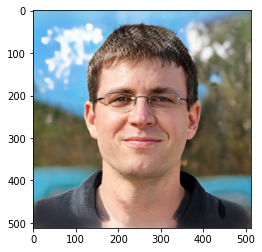

In [ ]:
from matplotlib import pyplot as plt
plt.imshow(img[0].detach().cpu().numpy())

index 0


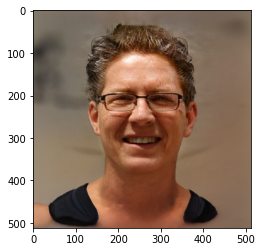

index 6


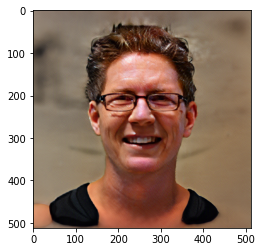

In [ ]:
from matplotlib import pyplot as plt
import imageio
from tqdm.notebook import tqdm
from google.colab.patches import cv2_imshow
import cv2
# Render video.
video_out = imageio.get_writer('out.mp4', mode='I', fps=10, codec='libx264')
save = False
original_ws = ws.clone()
interval = 1000
a = transform_latent(ws)
for i in range(0, int(7000/interval), 6):
  a[(i)*interval:(i+1)*interval] = 0.8
  temp_ws = transform_latent(a)
  img = G.synthesis(temp_ws[0:1], c[:1])[mode] # input a sample latent code ws and the respective camera parameters
  img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8) # convert to 8-bit
  print("index", i)
  plt.imshow(img[0].cpu().numpy())
  plt.show()
  #image_rgb = cv2.cvtColor(img[0].cpu().numpy(),cv2.COLOR_BGR2RGB)
  #cv2_imshow(image_rgb)
  
  # Save image
  if save:
    PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'{outdir}/{num:04d}.png')
  video_out.append_data(img[0].cpu().numpy())
video_out.close()

In [ ]:
#@title Visualize results
from IPython.display import HTML
from base64 import b64encode
mp4 = open('out.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Latent Code retargetting
Try to identify a connection between latent code and the semantic attributes and expressions, by merging 2 different latent codes. Control the effect of each latent code in the final image, by a weight parameter. After merging the 2 latent codes, you can inspect the semantic changes and the effect the weight parameter has on them. 
To disentagle the semantic attributes, form the latent code merging, you can try adding only specific parts of the latent code and inspecting the effect on the facial expressions.

In [ ]:
# @markdown Rendering arguments
rendering_kwargs = {'depth_resolution': 96, 'depth_resolution_importance': 96, 'ray_start': 2.25,
                    'ray_end': 3.3, 'box_warp': 1, 'avg_camera_radius': 2.7, 'avg_camera_pivot': [0, 0, 0.2],
                    'image_resolution': 512, 'disparity_space_sampling': True, 'clamp_mode': 'softplus',
                    'superresolution_module': 'training.superresolution.SuperresolutionHybrid8XDC',
                    'c_gen_conditioning_zero': True, 'c_scale': 1.0, 'superresolution_noise_mode': 'none',
                    'density_reg': 0.25, 'density_reg_p_dist': 0.004, 'reg_type': 'l1', 'decoder_lr_mul': 1.0,
                    'sr_antialias': True}

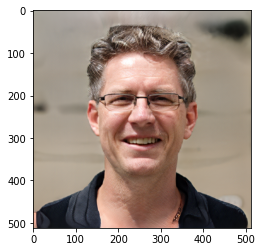

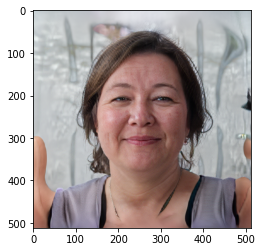

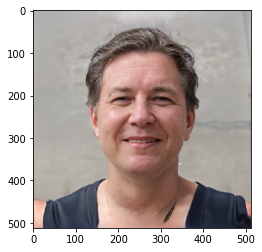

In [ ]:
from matplotlib import pyplot as plt
sampling_multiplier = 2
outpath = '/content/merge.png'
#@markdown Path to primary and secondary latent code
latent_root = '/content/drive/MyDrive/eg3d/experiments/latent_train10k_samples'
name = 'seed0005' #@param
name2 = 'seed0014' #@param 
latent_path = os.path.join(os.path.join(latent_root, name), 'out.npy') #@param
latent2_path = os.path.join(os.path.join(latent_root, name2), 'out.npy') #@param
#@markdown weighting of primary latent code
weight1 = 0.5 #@param
weight2 = 1- weight1 
#@markdown psi-truncation
psi = 0.5 #@param
#@markdown Choose mode (either 'image_depth' or 'image')
mode = "image" #@param
save = False #@param
grid = (1,1) # for a single image --> grid is (1x1)
grid_w = grid[0]
grid_h = grid[1]
num_keyframes = 1 # for single frame
wraps = 2 # default
kind='cubic'
fov_deg = 18.837
num = 30
depth_resolution = 96
depth_res_importance = 96
device = torch.device("cuda" if torch.cuda.is_available() else 'cpu')

# Define fixed camera parameters
c = torch.cat((torch.tensor([
                                [-1, 0,  0,  0],
                                [0,  -1, 0,  0],
                                [0,  0,  -1, 2.7],
                                [0,  0,  0,  1]
]).flatten(), torch.tensor([
                                        [3, 0, 0.5],
                                        [0, 3, 0.5],
                                        [0, 0, 5]
]).flatten())) # extrinsic and intrinsic matrix




# Load latent code
w = np.load(latent_path, allow_pickle=True) # load latent code
ws = torch.FloatTensor(w).cuda() # latent # 1, 14, 512

# Load secondary latent code
w2 = np.load(latent2_path, allow_pickle=True) # load latent code
ws2 = torch.FloatTensor(w2).cuda() # latent # 1, 14, 512

# Merge latent codes
w_final = weight1*ws + weight2*ws2

# get rigid transformation (does not change shape of object - preserve euclidian distance between points)
#cam2world_pose = LookAtPoseSampler.sample(3.14/2, 3.14/2, torch.tensor([0, 0, 0.2], device=device), radius=2.7, device=device)
#intrinsics = FOV_to_intrinsics(fov_deg, device=device)
#c = torch.cat([cam2world_pose.reshape(-1, 16), intrinsics.reshape(-1, 9)], 1) # camera pose (extrinsic + intrinsic params) - projection matrix
c = c.repeat(w_final.shape[0], 1).to(device)


# Generator
with dnnlib.util.open_url('/content/model.pkl') as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)  # type: ignore

# Setup rendering options for generator
G.rendering_kwargs['depth_resolution'] = int( depth_resolution * sampling_multiplier)
G.rendering_kwargs['depth_resolution_importance'] = int(depth_res_importance * sampling_multiplier)

# Assert latent format
if w_final.shape[1] != G.backbone.mapping.num_ws:
    w_final = w_final.repeat([1,G.backbone.mapping.num_ws, 1])

_ = G.synthesis(w_final[:1], c[:1])  # warm up - sampe from projected latent code (of input image) and generate the image
img1 = G.synthesis(ws[:1], c[:1])[mode]
img2 = G.synthesis(ws2[:1], c[:1])[mode]
img = G.synthesis(w_final[:1], c[:1])[mode] # input a sample latent code ws and the respective camera parameters
img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
img1 = (img1.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
img2 = (img2.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
if save:
  PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save('/content/merge.png')
  PIL.Image.fromarray(img1[0].cpu().numpy(), 'RGB').save('/content/img1.png')
  PIL.Image.fromarray(img2[0].cpu().numpy(), 'RGB').save('/content/img2.png')
  print("Image 1 and Image 2 and the merged result can be found under /content/")
else:
  plt.imshow(img1[0].cpu().numpy())
  plt.show()
  plt.imshow(img2[0].cpu().numpy())
  plt.show()
  plt.imshow(img[0].cpu().numpy())
  plt.show()

In [ ]:
# Find mean neutral expression
mean_neutral = w_final

index 3000


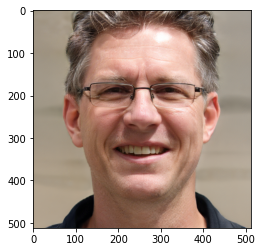

index 3020


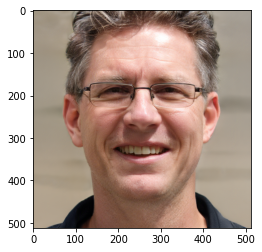

index 3040


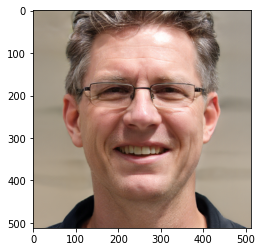

index 3060


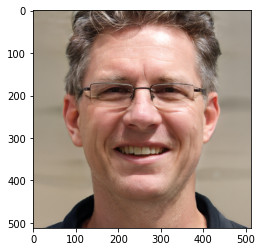

index 3080


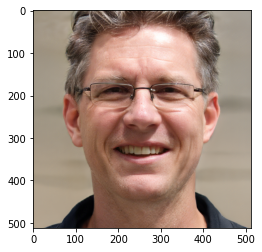

index 3100


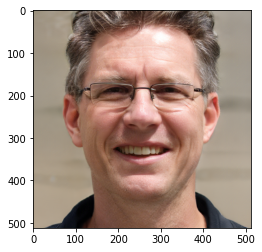

index 3120


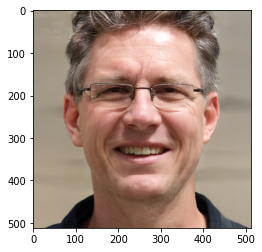

index 3140


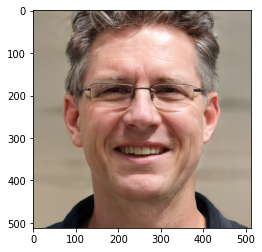

index 3160


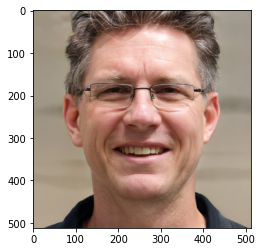

index 3180


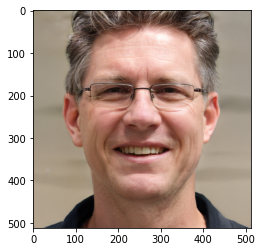

index 3200


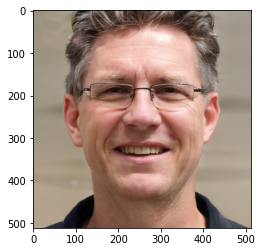

index 3220


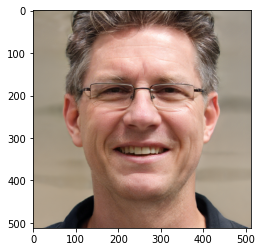

index 3240


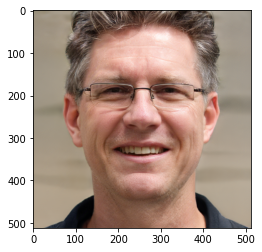

index 3260


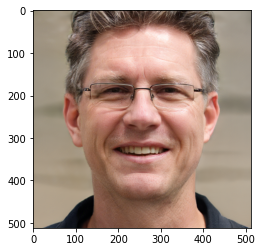

index 3280


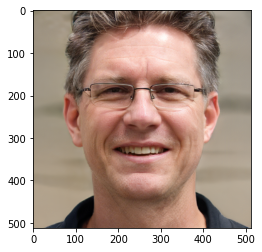

index 3300


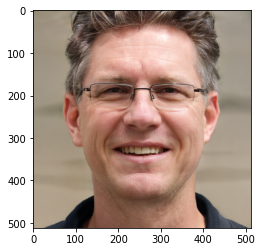

index 3320


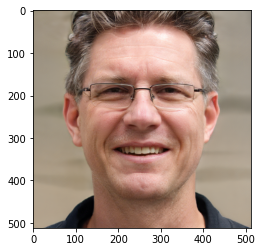

index 3340


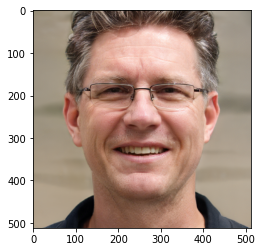

index 3360


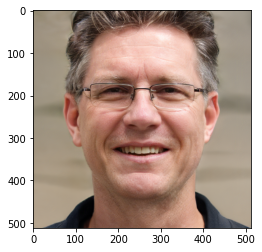

index 3380


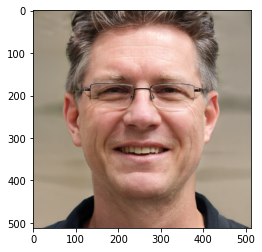

index 3400


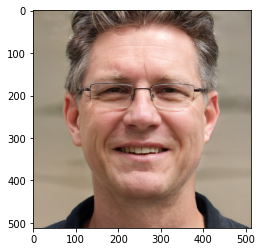

index 3420


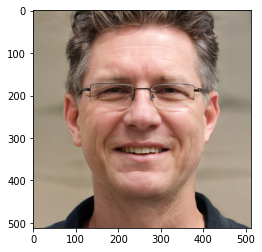

index 3440


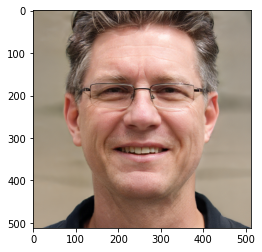

index 3460


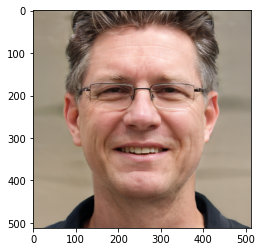

index 3480


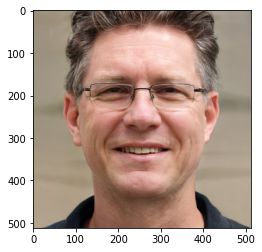

index 3500


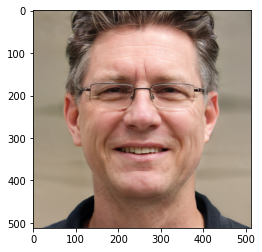

index 3520


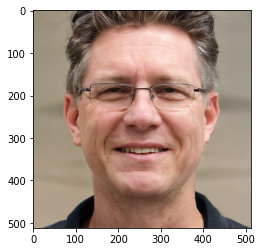

index 3540


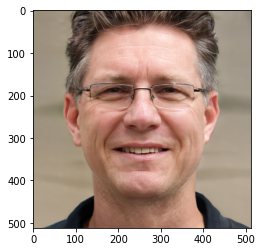

index 3560


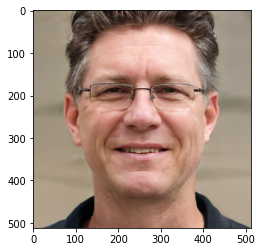

index 3580


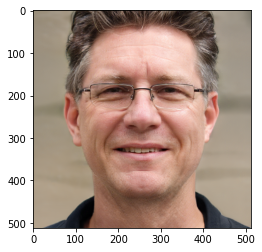

index 3600


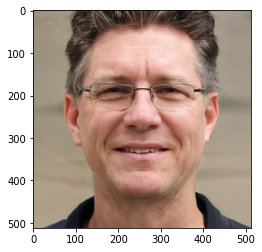

index 3620


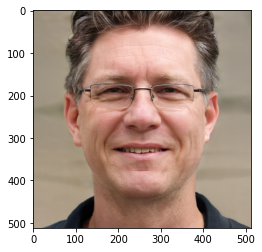

index 3640


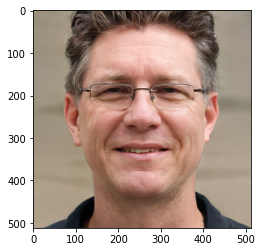

index 3660


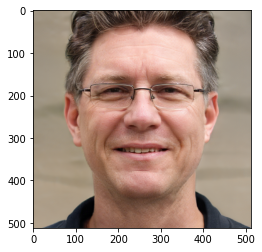

index 3680


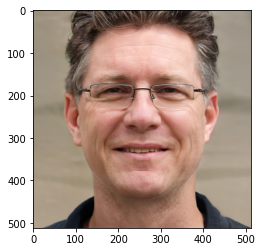

index 3700


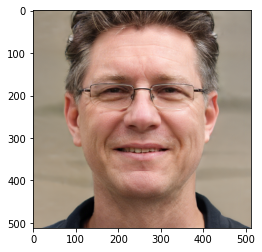

index 3720


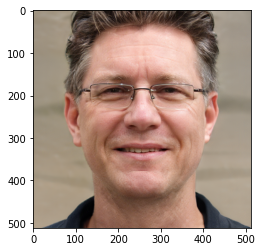

index 3740


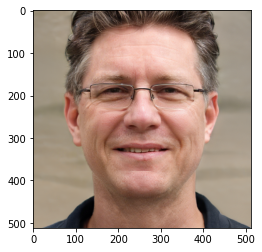

index 3760


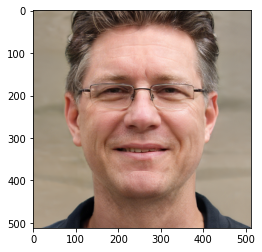

index 3780


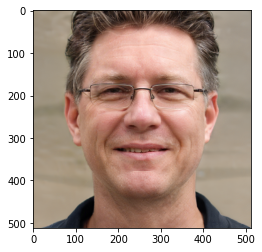

index 3800


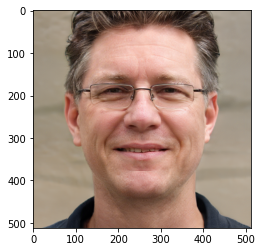

index 3820


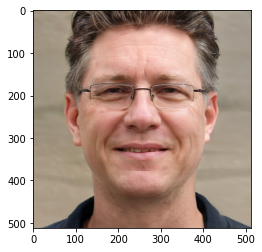

index 3840


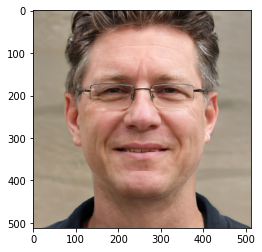

index 3860


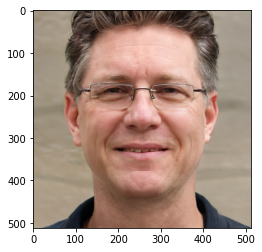

index 3880


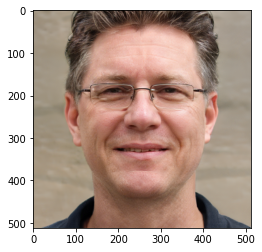

index 3900


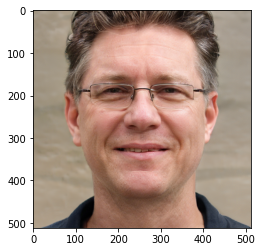

index 3920


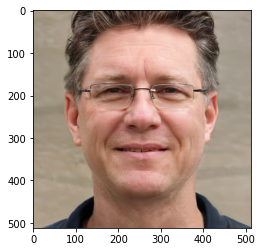

index 3940


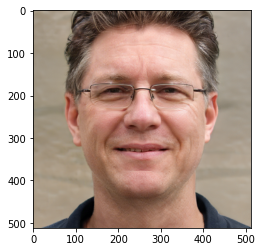

index 3960


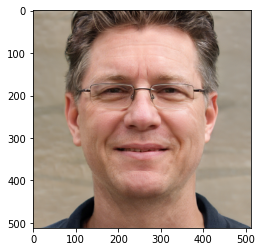

index 3980


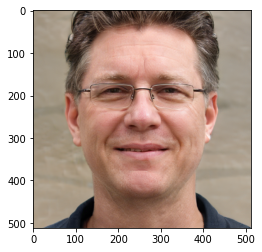

In [ ]:
from matplotlib import pyplot as plt
import imageio
from tqdm.notebook import tqdm
from google.colab.patches import cv2_imshow
import cv2
# Render video.
video_out = imageio.get_writer('out.mp4', mode='I', fps=30, codec='libx264')
save = False
code1 = ws.clone()
code2 = mean_neutral.clone()
vec1 = transform_latent(code1)
vec2 = transform_latent(code2)
interval = 20 # step size of loop
weight1 = 0.2
weight2 = 0.8
vec = vec1.clone() # initialize
for i in range(3000, 4000, interval):
  vec[i:i+interval] = weight2* vec2[i:i+interval] #+ weight1*vec[i:i+interval]
  code = transform_latent(vec)
  img = G.synthesis(code[0:1], c[:1])[mode] # input a sample latent code ws and the respective camera parameters
  img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8) # convert to 8-bit
  print("index", i)
  plt.imshow(img[0].cpu().numpy())
  plt.show()
  #image_rgb = cv2.cvtColor(img[0].cpu().numpy(),cv2.COLOR_BGR2RGB)
  #cv2_imshow(image_rgb)
  # Save image
  if save:
    PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'out/{i:04d}.png')
  video_out.append_data(img[0].cpu().numpy())
video_out.close()

In [ ]:
print(np.mean(vec2[3000:3100].cpu().numpy()),
np.mean(vec2[3100:3200].cpu().numpy()),
np.mean(vec2[3200:3300].cpu().numpy()),
np.mean(vec2[3300:3400].cpu().numpy()),
np.mean(vec2[3400:3500].cpu().numpy()),
np.mean(vec2[3500:3600].cpu().numpy()),
np.mean(vec2[3600:3700].cpu().numpy()),
np.mean(vec2[3700:3800].cpu().numpy()),
)

split = {3000: 0.118418664, 3100: 0.14166066, 3200: 0.11861, 3300: 0.14212929, 3400: 0.16443607, 3500: 0.14264327, 3600:0.1480611, 3700: 0.13045631}

0.12200758 0.1580326 0.15080436 0.16485935 0.18859889 0.1416794 0.16943245 0.14323503


In [ ]:
#@title Visualize results
from IPython.display import HTML
from base64 import b64encode
mp4 = open('out.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Succesful Experiments

### Gender Interpolation

Notes

- Femalize --> i  = 0-300 with value 3 and above (more positive values means more female)

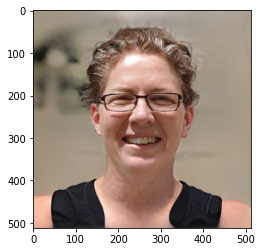

In [ ]:
from matplotlib import pyplot as plt
import imageio
from tqdm.notebook import tqdm
from google.colab.patches import cv2_imshow
import cv2
# Render video.
video_out = imageio.get_writer('/content/drive/MyDrive/eg3d/latent_exploration/male_to_female.mp4', mode='I', fps=10, codec='libx264')
save = False
original_ws = ws.clone()
frames = 100
for i in range(frames):
  a = transform_latent(ws)
  #a[(i)*interval:(i+1)*interval] = -1
  a[0:300] = norm_to_range(i, max=7, min=0) 
  temp_ws = transform_latent(a)
  img = G.synthesis(temp_ws[0:1], c[:1])[mode] # input a sample latent code ws and the respective camera parameters
  img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8) # convert to 8-bit
  plt.imshow(img[0].cpu().numpy())
  #plt.show()
  
  # Save image
  if save:
    PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'{outdir}/{i:04d}.png')
  video_out.append_data(img[0].cpu().numpy())
video_out.close()

In [ ]:
#@title Visualize results
from IPython.display import HTML
from base64 import b64encode
mp4 = open('male_to_female.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

### Glasses Interpolation

Notes

- remove_glasses --> i  = 2400 - 2500 with value 0.8 (more positive values means no glasses scale, more negative means darker glasses)

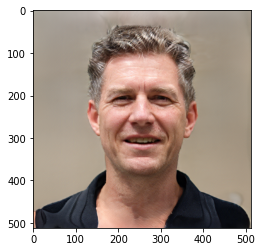

In [ ]:
from matplotlib import pyplot as plt
import imageio
from tqdm.notebook import tqdm
from google.colab.patches import cv2_imshow
import cv2
# Render video.
video_out = imageio.get_writer('glasses.mp4', mode='I', fps=10, codec='libx264')
save = True
original_ws = ws.clone()
frames = 100
for i in range(frames):
  a = transform_latent(ws)
  #a[(i)*interval:(i+1)*interval] = -1
  a[2400:2500] = norm_to_range(i, max=1, min=-1)
  temp_ws = transform_latent(a)
  img = G.synthesis(temp_ws[0:1], c[:1])[mode] # input a sample latent code ws and the respective camera parameters
  img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8) # convert to 8-bit
  plt.imshow(img[0].cpu().numpy())
  #plt.show()
  
  # Save image
  if save:
    PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'{outdir}/{i:04d}.png')
  video_out.append_data(img[0].cpu().numpy())
video_out.close()

In [ ]:
#@title Visualize results
from IPython.display import HTML
from base64 import b64encode
mp4 = open('glasses.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Dumb

In [ ]:
def generate(z, c=c, device=device, psi=psi):
    return G(z, c.to(device).unsqueeze(0).repeat(z.shape[0], 1),
             truncation_psi=psi)
    
def to_img(img, mode='image', as_torch=False, as_numpy=False):
  if mode == 'image':
    img = img[mode][0].permute(1, 2, 0) / 3 + 0.5
    if as_torch:
        return img
    img = img.detach().cpu().numpy()
    if as_numpy:
        return img
    return Image.fromarray((np.clip(img, 0, 1) * 255).astype(np.uint8))
  elif mode == 'image_depth':
    img = img[mode][0]
    return img

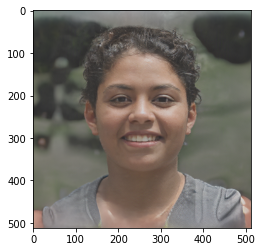

In [ ]:
from matplotlib import pyplot as plt
import imageio
from tqdm.notebook import tqdm
# Render video.
video_out = imageio.get_writer('out.mp4', mode='I', fps=30, codec='libx264')
single_w = w[0,0]
for i in range(w.shape[2]):
  single_w[i] = single_w[i] + z # change 1 vector position, by adding a small pertrubation
  w_torch = torch.from_numpy(single_w).to(device).unsqueeze(0)   # place latent code in appropriate device
  #w_torch = w_torch + z
  img = generate(w_torch)
  img_plot = to_img(img)
  img_np = to_img(img, as_numpy=True)
  #img = img["image"][0].permute(1, 2, 0) / 3 + 0.5
  plt.imshow(img_plot)
  video_out.append_data(img_np)
  #img_plot.save('/content/img.png')
  del img
  del w_torch
  gc.collect()
  if i == 512 :
    break
video_out.close()


In [ ]:
# Interpolation.
grid = []
for yi in range(grid_h):
    row = []
    for xi in range(grid_w):
        x = np.arange(-num_keyframes * wraps, num_keyframes * (wraps + 1))
        y = np.tile(ws[yi][xi].cpu().numpy(), [wraps * 2 + 1, 1, 1]) # (5, 14, 512)
        interp = scipy.interpolate.interp1d(x, y, kind=kind, axis=0)
        row.append(interp)
    grid.append(row)

In [ ]:
def linear_interpolate(latent_code,
                       boundary,
                       start_distance=-3.0,
                       end_distance=3.0,
                       steps=10):
  """Manipulates the given latent code with respect to a particular boundary.
  Basically, this function takes a latent code and a boundary as inputs, and
  outputs a collection of manipulated latent codes. For example, let `steps` to
  be 10, then the input `latent_code` is with shape [1, latent_space_dim], input
  `boundary` is with shape [1, latent_space_dim] and unit norm, the output is
  with shape [10, latent_space_dim]. The first output latent code is
  `start_distance` away from the given `boundary`, while the last output latent
  code is `end_distance` away from the given `boundary`. Remaining latent codes
  are linearly interpolated.
  Input `latent_code` can also be with shape [1, num_layers, latent_space_dim]
  to support W+ space in Style GAN. In this case, all features in W+ space will
  be manipulated same as each other. Accordingly, the output will be with shape
  [10, num_layers, latent_space_dim].
  NOTE: Distance is sign sensitive.
  Args:
    latent_code: The input latent code for manipulation.
    boundary: The semantic boundary as reference.
    start_distance: The distance to the boundary where the manipulation starts.
      (default: -3.0)
    end_distance: The distance to the boundary where the manipulation ends.
      (default: 3.0)
    steps: Number of steps to move the latent code from start position to end
      position. (default: 10)
  """
  assert (latent_code.shape[0] == 1 and boundary.shape[0] == 1 and
          len(boundary.shape) == 2 and
          boundary.shape[1] == latent_code.shape[-1])

  linspace = np.linspace(start_distance, end_distance, steps)
  if len(latent_code.shape) == 2:
    linspace = linspace - latent_code.dot(boundary.T)
    linspace = linspace.reshape(-1, 1).astype(np.float32)
    return latent_code + linspace * boundary
  if len(latent_code.shape) == 3:
    linspace = linspace.reshape(-1, 1, 1).astype(np.float32)
    return latent_code + linspace * boundary.reshape(1, 1, -1)
  raise ValueError(f'Input `latent_code` should be with shape '
                   f'[1, latent_space_dim] or [1, N, latent_space_dim] for '
                   f'W+ space in Style GAN!\n'
                   f'But {latent_code.shape} is received.')

### Invert Image

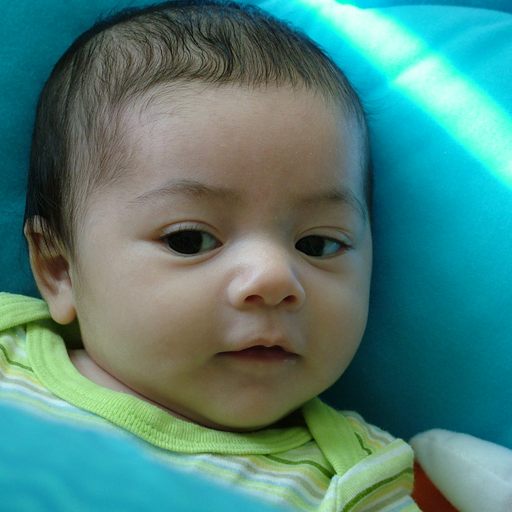

In [ ]:
#@title Invert your own image
from PIL import Image
import requests
import io
import os


download = lambda x: Image.open(io.BytesIO(requests.get(x).content))
#@markdown Image URL. Leave empty if you upload your own
url = "" #@param ["https://thispersondoesnotexist.com/image", ""] {allow-input: true}
#@markdown (Optional) image path if you upload your own
path = "/content/drive/MyDrive/datasets/FFHQ/00000/00000.png"  #@param {type: "string"}
if len(url):
    target = download(url)
else:
    if not os.path.exists(path):
        from google.colab import files
        print("Upload image:")
        uploaded = list(files.upload())
        if uploaded:
            path = uploaded[0]
        else:
            print("Please upload something. Erroring out soon...")
    target = Image.open(path)
target = torch.from_numpy(np.asarray(target.convert("RGB").resize(
    (512, 512))) / 255).to(device)
Image.fromarray((target.detach().cpu().numpy() * 255).astype(np.uint8))

In [ ]:
from IPython.display import display, clear_output
from tqdm.auto import tqdm, trange
from ipywidgets import Output
import camera_utils
import lpips
import os


#@markdown ## Geometry
#@markdown Default camera focal length (tune to match your camera's zoom, 3-6
#@markdown are good values)
focal_length =   4#@param {type: "number"}
focal_length = torch.nn.Parameter(torch.tensor([focal_length],
                                               dtype=torch.float32,
                                               device=device))
#@markdown Default offset (don't go below 2.8, you'll get body horror)
start_z = 3.2  #@param {type: "number"}
try:
    position
except NameError:
    position = torch.nn.Parameter(
        torch.tensor([0, 0, start_z], dtype=torch.float32, device=device))
try:
    rotation
except NameError:
    rotation = torch.nn.Parameter(
        torch.tensor([0, 0, 0], dtype=torch.float32, device=device))
#@markdown ## Init
#@markdown Random seed, 0 for no seed
seed =   25#@param {type: "integer"}
if seed == 0:
    import random
    seed = random.getrandbits(16)
print("Seed:", seed)
torch.manual_seed(seed)
#@markdown How much to scale down the intialisation by (more conservative)
init_scale = 0.9  #@param {type: "number"}
#@markdown Start from a new face latent instead of reusing (turn off if you
#@markdown know what you're doing)
generate_new = True  #@param {type: "boolean"}
try:
    z
    if generate_new:
        abracadabra  # What if someone makes a variable with that name?
except NameError:
    try:
        z_random
        if generate_new:
            abracadabra
    except NameError:
        print('Hello')
        z_random = torch.randn([1, G.z_dim], dtype=torch.float32, device=device)
    z = torch.nn.Parameter(z_random[0] * init_scale)


# It would be shorter to just hardcode
def rotation_matrix(angle, dim=0):
    s = angle.sin()
    c = angle.cos()
    dims = [d for d in range(3) if d != dim]
    return torch.zeros(9).to(angle).index_add(
        0,
        torch.LongTensor([dims[0] + dims[0] * 3,
                          dims[1] + dims[0] * 3,
                          dims[0] + dims[1] * 3,
                          dims[1] + dims[1] * 3, dim + dim * 3
                          ]).to(angle.device), torch.cat([c, s, -s, c,
                                                          angle * 0 + 1
                                                          ])).reshape(3, 3)


def rotate(euler):
    return (
        rotation_matrix(euler[0:1], 0)
        @ rotation_matrix(euler[1:2], 1)
        @ rotation_matrix(euler[2:3], 2))


def get_cam_matrix():
    return torch.tensor(
        [
            [0, 0, 0.5],
            [0, 0, 0.5],
            [0, 0, 1]
        ], dtype=torch.float32, device=device).flatten().index_add(
            0,
            torch.LongTensor([0, 4]).to(device),
            torch.cat((focal_length,) * 2)).reshape(3, 3)


def make_c():
    matrix = torch.tensor([
                        [-1, 0,  0],
                        [0, -1,  0],
                        [0,  0, -1]
    ]).float().to(device)
    matrix = matrix @ rotate(rotation)
    # Position is not rotated
    pos = torch.maximum(torch.tensor([-10, -10, 2.6]).to(position),
                        position)
    matrix = torch.cat((matrix, pos.unsqueeze(-1)), dim=1)
    matrix = torch.cat((matrix, torch.eye(4)[-1:].to(device)), dim=0)
    cam_matrix = get_cam_matrix().flatten()
    return torch.cat((matrix.flatten(), cam_matrix)).float().to(device)


def render():
    return generate(z.unsqueeze(0), make_c()), weights(z.unsqueeze(0), make_c())


#@markdown ## Training
#@markdown (note: you can always interrupt execution and continue with different
#@markdown parameters)
# TODO Make the interrupt begin the fly-around iterations
# TODO show a higher-res image at the end? Or separate images
#@markdown Number of training interations
iterations =   1000  #@param {type: "integer"}
#@markdown Iterations in the end to just fly around
show_iterations = 200  #@param {type: "integer"}
#@markdown Display images every N training steps (make this higher if you see
#@markdown flickering or the notebook slows down)
show_every = 1  #@param {type: "integer"}
#@markdown Save every N steps
save_every = 60  #@param {type: "integer"}
#@markdown Save to this file
save_to = "EG3D.pt"  #@param {type: "string"}
#@markdown Master learning rate
lr =   0.4  #@param {type: "number"}
#@markdown Position, rotation and focal length learning rate
p_lr = 4e-2  #@param {type: "number"}
#@markdown Generator latent learning rate
z_lr = 2e-1  #@param {type: "number"}
#@markdown PTI learning rate
g_lr = 0.0  #@param {type: "number"}
#@,arldpwm Gradient clipping norm
clip_grad_norm = 10.0  #@param {type: "number"}
#@markdown How much to take position into account for loss (experimental)
weight_weight = 0.0  #@param {type: "number"}
#@markdown Loss weight for L2 regularization on latents
reg_weight = 0.01  #@param {type: "number"}
#@markdown Network to be used for LPIPS
lpips_net = "vgg"  #@param {type: "string"} ["vgg", "alex"]
#@markdown LPIPS loss weight
perceptual_weight = 0.2  #@param {type: "number"}
# TODO: add face landmark alignment loss

perceptual_loss = lpips.LPIPS(net=lpips_net).to(device)
optim = torch.optim.Adam([{"params": [position, rotation, focal_length],
                           "lr": p_lr * lr},
                          {"params": [z], "lr": z_lr * lr},
                          {"params": G.parameters(), "lr": g_lr * lr}])
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optim, iterations,
                                                       eta_min=1e-4)
out = Output()
display(out)
frames = []
try:
    with trange((iterations + show_iterations)) as bar:
        for i in bar:
            pic = generate(z.unsqueeze(0), make_c())
            weight =  weights(z.unsqueeze(0), make_c())
            im = to_img(pic, as_torch=True)
            losses = ((im - target) ** 2).mean(dim=-1)
            weight = torch.nn.functional.interpolate(
                weight.unsqueeze(0).unsqueeze(0), (im.shape[0], im.shape[1]))[0, 0]
            weight = weight * weight_weight + (1 - weight_weight)
            mse = (losses * weight.detach()).mean()
            reg = torch.norm(z)
            perceptual = perceptual_loss(
                im.unsqueeze(0).permute(0, 3, 1, 2) * 2 - 1,
                target.unsqueeze(0).permute(0, 3, 1, 2).float() * 2 - 1)
            loss = (
                mse
                + reg * reg_weight
                + perceptual * perceptual_weight)
            bar.set_postfix(loss=loss.item(), mse=mse.item(), reg=reg.item(),
                            perceptual=perceptual.item())
            if i < iterations:
                loss.backward()
                for group in optim.param_groups:
                    torch.nn.utils.clip_grad_norm_(group["params"], clip_grad_norm)
                optim.step()
                optim.zero_grad()
                scheduler.step()
            frame = to_img(pic)
            angle = i / 10
            angled_c = camera_utils.LookAtPoseSampler().sample(
                np.sin(angle) / 2 + np.pi / 2,
                np.cos(np.sin(angle / 2) / 2) / 2 * np.pi,
                torch.zeros(3), radius=start_z)
            pic2 = generate(z.unsqueeze(0),
                            torch.cat((angled_c.flatten().to(device),
                                    get_cam_matrix().flatten())).float().to(
                                        device))
            depth = torch.nn.functional.interpolate(pic2["image_depth"], im.shape[:2]
                                            )[0, 0].cpu().detach().numpy()
            depth -= depth.min()
            depth *= depth.max()
            depth = np.tile((depth[:, :, np.newaxis] * 255).astype(np.uint8),
                            (1, 1, 3))
            frame = Image.fromarray(np.concatenate((
                np.concatenate((
                    np.asarray(frame),
                    depth
                ), axis=0),
                np.concatenate((
                    (np.asarray(target.detach().cpu().numpy())
                    * 255).astype(np.uint8), np.asarray(to_img(pic2))
                ), axis=0)
            ), axis=1))
            frames.append(frame)
            if i % show_every == show_every - 1:
                with out:
                    clear_output(wait=True)
                    display(frame)
            if i % save_every == save_every - 1:
                torch.save((z, (position, rotation, focal_length)), save_to)
except KeyboardInterrupt:
    print("Early exit")

Seed: 25
Hello
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.7/dist-packages/lpips/weights/v0.1/vgg.pth


Output()

  0%|          | 0/1200 [00:00<?, ?it/s]

AssertionError: ignored

In [ ]:
import gc
del pic
gc.collect()

NameError: ignored


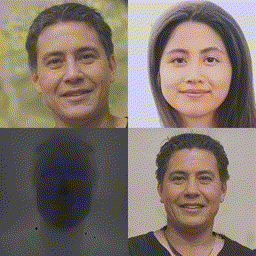

In [ ]:
#@title Save optimization video
from IPython.display import display, HTML
from skvideo.io import FFmpegWriter
from base64 import b64encode


def save_gif(frames, out_path="video.mp4", display=False):
    if display:
        tq = tqdm
    else:
        tq = lambda x: x
    writer = FFmpegWriter(out_path)
    for frame in tq(frames):
        writer.writeFrame(np.asarray(frame))
        if display:
            from IPython.display import display as show
            show(frame)
    writer.close()


#@markdown Set to 128 if the notebook crashes
resolution = 256  #@param {type: "integer"}
out_path = "video.gif"  #@param {type: "string"}
save_gif([f.resize((resolution, resolution)) for f in frames], out_path)
video = open(out_path, "rb").read()
data_url = f"data:image/gif;base64," + b64encode(video).decode()
display(HTML(f"<img src={data_url}>"))

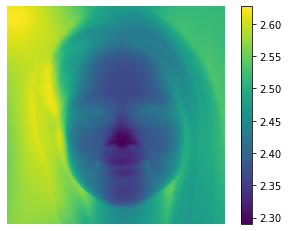

  0%|          | 0/128 [00:00<?, ?it/s]

In [ ]:
#@title (Experimental) 3D Export
import trimesh


im = to_img(pic, as_numpy=True)
im = im[::4, ::4]
focus = (1 / focal_length).item()
step = focus / im.shape[0] * 2
rays = np.mgrid[-focus:focus:step,
                -focus:focus:step]
pic = generate(z.unsqueeze(0), make_c())
depth = torch.nn.functional.interpolate(pic["image_depth"], im.shape[:2]
                                        )[0, 0].cpu().detach().numpy()
plt.axis("off")
plt.imshow(depth)
plt.colorbar()
plt.show()
xyz = np.concatenate(((rays * depth).transpose(1, 2, 0),
                      depth[..., np.newaxis]),
                     axis=-1).reshape(-1, 3)
colors = im.reshape(-1, 3)
faces = []
c = lambda x, y: y * im.shape[1] + x
for y in trange(im.shape[0]):
    for x in range(im.shape[1]):
        if x > 0 and y > 0:
            faces.append([c(x, y), c(x, y - 1), c(x - 1, y)])
        if x < im.shape[1] - 1 and y < im.shape[0] - 1:
            faces.append([c(x, y), c(x, y + 1), c(x + 1, y)])
face_colors = np.asarray([colors[i[0]] for i in faces])
texture = Image.fromarray((im * 255).astype(np.uint8))
uv = np.mgrid[0:im.shape[0], 0:im.shape[1]].reshape(2, -1).T
tri_mesh = trimesh.Trimesh(vertices=xyz[..., [1, 0, 2]] * -1,
                           faces=faces,
                           vertex_colors=colors,
                           smooth=True)

In [ ]:
#@title Save mesh
from datetime import datetime


#@markdown Name of the file (leave empty to name automatically)
mesh_path = ""  #@param ["", "eg3d.ply"] {type: "string", allow-input: true}
#@markdown Path to save in google drive, leave empty if you want to store it in the Colab session only
drive_path = "EG3D"  #@param ["", "EG3D"] {type: "string", allow-input: true}
if not mesh_path:
    # TODO use hash of source image instead?
    mesh_path = f"e-{datetime.strftime(datetime.now(),'%Y_%m_%d-%H_%M_%S')}.ply"

#@markdown Download the resulting .obj file?
download_mesh = True  #@param {type: "boolean"}
kwargs = dict()  # TODO put something here
tri_mesh.export(mesh_path, **kwargs)

if download_mesh:
    from google.colab import files
    files.download(mesh_path)

if drive_path:
    from google.colab import drive
    print("Mounting drive...")
    drive.mount("/content/drive/")
    print("Saving to drive...")
    drive_path = f"/content/drive/MyDrive/{drive_path}"
    os.makedirs(drive_path, exist_ok=True)
    tri_mesh.export(f"{drive_path}/{mesh_path}", **kwargs)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Mounting drive...
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Saving to drive...
